# Ames Housing for Developers

## Business Case

House flipping can be a profitable business but its not without its risk.  Doing work on a home requires substanial financial investment and understanding your profit margins can be a tricky thing.  Working as a consultant for a local developer, I am going to determine the key predictors of sales price and quantify how each of them affects sales price.  I am then going to find which neighborhoods and building types developers should target of maximum profit.

## Objective

We are going to quantify the monetary values of various components of a home and create price prediction with a linear regression.  We are then going to determine which types of home a developer should be targeting for being return on investment in terms of home type and location.

## Methodology

1. Clean Data and make sure no Nan values and dropping unused columns
2. Visualize Data
3. Train and Evaluate Linear Regression Model
4. Iterate to improve model scoring with feature engineering and data scaling
5. Determine which features are most critical and determine which home type and location should be targeted by developers

## Means of Analysis

R-squared: This score represents how much of the variance in the data can be explained by the regression model. We want this number to be as close to 1 as possible. Any variance not explained by the model is explained by error. R-squared represents a goodness of fit test.

P-values: P- values for our independent variables should be below .05 in order to us to reject the null hypothesis.

RMSE: Root mean squared error measures the differences between the values the model estimates and the values observed. We want this number to be as small as possible. In this case it represents the dollar value of expected error for each variable. We used this instead of MAE because it is more sensitive to outliers.

In [416]:
#making necessary imports
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import statsmodels.api as sm
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn import metrics
from sklearn.metrics import r2_score
import scipy.stats as stats
df= pd.read_csv('AmesHousing.csv')
from statsmodels.stats.outliers_influence import variance_inflation_factor
import pandas as pd
from sklearn.linear_model import Lasso
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from math import sqrt


In [417]:
df

,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,1,526301100,20,RL,141.0,31770,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,5,1960,1960,Hip,CompShg,BrkFace,Plywood,Stone,112.0,TA,TA,CBlock,TA,Gd,Gd,BLQ,639.0,Unf,0.0,441.0,1080.0,GasA,Fa,Y,SBrkr,1656,0,0,1656,1.0,0.0,1,0,3,1,TA,7,Typ,2,Gd,Attchd,1960.0,Fin,2.0,528.0,TA,TA,P,210,62,0,0,0,0,NaN,NaN,NaN,0,5,2010,WD,Normal,215000
1,2,526350040,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,NaN,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal,105000
2,3,526351010,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108.0,TA,TA,CBlock,TA,TA,No,ALQ,923.0,Unf,0.0,406.0,1329.0,GasA,TA,Y,SBrkr,1329,0,0,1329,0.0,0.0,1,1,3,1,Gd,6,Typ,0,NaN,Attchd,1958.0,Unf,1.0,312.0,TA,TA,Y,393,36,0,0,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal,172000
3,4,526353030,20,RL,93.0,11160,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,7,5,1968,1968,Hip,CompShg,BrkFace,BrkFace,None,0.0,Gd,TA,CBlock,TA,TA,No,ALQ,1065.0,Unf,0.0,1045.0,2110.0,GasA,Ex,Y,SBrkr,2110,0,0,2110,1.0,0.0,2,1,3,1,Ex,8,Typ,2,TA,Attchd,1968.0,Fin,2.0,522.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal,244000
4,5,527105010,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,791.0,Unf,0.0,137.0,928.0,GasA,Gd,Y,SBrkr,928,701,0,1629,0.0,0.0,2,1,3,1,TA,6,Typ,1,TA,Attchd,1997.0,Fin,2.0,482.0,TA,TA,Y,212,34,0,0,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal,189900
5,6,527105030,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,6,1998,1998,Gable,CompShg,VinylSd,VinylSd,BrkFace,20.0,TA,TA,PConc,TA,TA,No,GLQ,602.0,Unf,0.0,324.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,1998.0,Fin,2.0,470.0,TA,TA,Y,360,36,0,0,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal,195500
6,7,527127150,120,RL,41.0,4920,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,2001,2001,Gable,CompShg,CemntBd,CmentBd,None,0.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,616.0,Unf,0.0,722.0,1338.0,GasA,Ex,Y,SBrkr,1338,0,0,1338,1.0,0.0,2,0,2,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,582.0,TA,TA,Y,0,0,170,0,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal,213500
7,8,527145080,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,PConc,Gd,TA,No,ALQ,263.0,Unf,0.0,1017.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1992.0,RFn,2.0,506.0,TA,TA,Y,0,82,0,0,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal,191500
8,9,527146030,120,RL,39.0,5389,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1995,1996,Gable,CompShg,CemntBd,CmentBd,None,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,1180.0,Unf,0.0,415.0,1595.0,GasA,Ex,Y,SBrkr,1616,0,0,1

In [418]:
#view all columns
pd.set_option('display.max_columns', None)
df

,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,1,526301100,20,RL,141.0,31770,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,5,1960,1960,Hip,CompShg,BrkFace,Plywood,Stone,112.0,TA,TA,CBlock,TA,Gd,Gd,BLQ,639.0,Unf,0.0,441.0,1080.0,GasA,Fa,Y,SBrkr,1656,0,0,1656,1.0,0.0,1,0,3,1,TA,7,Typ,2,Gd,Attchd,1960.0,Fin,2.0,528.0,TA,TA,P,210,62,0,0,0,0,NaN,NaN,NaN,0,5,2010,WD,Normal,215000
1,2,526350040,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,NaN,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal,105000
2,3,526351010,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108.0,TA,TA,CBlock,TA,TA,No,ALQ,923.0,Unf,0.0,406.0,1329.0,GasA,TA,Y,SBrkr,1329,0,0,1329,0.0,0.0,1,1,3,1,Gd,6,Typ,0,NaN,Attchd,1958.0,Unf,1.0,312.0,TA,TA,Y,393,36,0,0,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal,172000
3,4,526353030,20,RL,93.0,11160,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,7,5,1968,1968,Hip,CompShg,BrkFace,BrkFace,None,0.0,Gd,TA,CBlock,TA,TA,No,ALQ,1065.0,Unf,0.0,1045.0,2110.0,GasA,Ex,Y,SBrkr,2110,0,0,2110,1.0,0.0,2,1,3,1,Ex,8,Typ,2,TA,Attchd,1968.0,Fin,2.0,522.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal,244000
4,5,527105010,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,791.0,Unf,0.0,137.0,928.0,GasA,Gd,Y,SBrkr,928,701,0,1629,0.0,0.0,2,1,3,1,TA,6,Typ,1,TA,Attchd,1997.0,Fin,2.0,482.0,TA,TA,Y,212,34,0,0,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal,189900
5,6,527105030,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,6,1998,1998,Gable,CompShg,VinylSd,VinylSd,BrkFace,20.0,TA,TA,PConc,TA,TA,No,GLQ,602.0,Unf,0.0,324.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,1998.0,Fin,2.0,470.0,TA,TA,Y,360,36,0,0,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal,195500
6,7,527127150,120,RL,41.0,4920,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,2001,2001,Gable,CompShg,CemntBd,CmentBd,None,0.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,616.0,Unf,0.0,722.0,1338.0,GasA,Ex,Y,SBrkr,1338,0,0,1338,1.0,0.0,2,0,2,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,582.0,TA,TA,Y,0,0,170,0,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal,213500
7,8,527145080,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,PConc,Gd,TA,No,ALQ,263.0,Unf,0.0,1017.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1992.0,RFn,2.0,506.0,TA,TA,Y,0,82,0,0,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal,191500
8,9,527146030,120,RL,39.0,5389,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1995,1996,Gable,CompShg,CemntBd,CmentBd,None,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,1180.0,Unf,0.0,415.0,1595.0,GasA,Ex,Y,SBrkr,1616,0,0,1

## Cleaning Data

In [419]:
#getting a better understanding of the values of each column
for col in df.columns:
    print(df[col].value_counts())






2047    1
1086    1
1082    1
1080    1
1078    1
1076    1
1074    1
1072    1
1070    1
1068    1
1066    1
1064    1
1062    1
1060    1
1058    1
1056    1
1054    1
1052    1
1050    1
1048    1
1046    1
1084    1
1088    1
1042    1
1090    1
1128    1
1126    1
1124    1
1122    1
1120    1
1118    1
1116    1
1114    1
1112    1
1110    1
1108    1
1106    1
1104    1
1102    1
1100    1
1098    1
1096    1
1094    1
1092    1
1044    1
1040    1
1132    1
994     1
990     1
988     1
986     1
984     1
982     1
980     1
978     1
976     1
974     1
972     1
970     1
968     1
966     1
964     1
962     1
960     1
958     1
956     1
954     1
992     1
996     1
1038    1
998     1
1036    1
1034    1
1032    1
1030    1
1028    1
1026    1
1024    1
1022    1
1020    1
1018    1
1016    1
1014    1
1012    1
1010    1
1008    1
1006    1
1004    1
1002    1
1000    1
1130    1
1134    1
2781    1
1270    1
1266    1
1264    1
1262    1
1260    1
1258    1
1256    1


The class and zoning are labeled in code which needs to be converted to actual information it represents.  We will do this with mapping.

In [420]:
# Define the mappings
subclass_mapping = {
    20: '1-STORY 1946 & NEWER ALL STYLES',
    30: '1-STORY 1945 & OLDER',
    40: '1-STORY W/FINISHED ATTIC ALL AGES',
    45: '1-1/2 STORY - UNFINISHED ALL AGES',
    50: '1-1/2 STORY FINISHED ALL AGES',
    60: '2-STORY 1946 & NEWER',
    70: '2-STORY 1945 & OLDER',
    75: '2-1/2 STORY ALL AGES',
    80: 'SPLIT OR MULTI-LEVEL',
    85: 'SPLIT FOYER',
    90: 'DUPLEX - ALL STYLES AND AGES',
    120: '1-STORY PUD (Planned Unit Development) - 1946 & NEWER',
    150: '1-1/2 STORY PUD - ALL AGES',
    160: '2-STORY PUD - 1946 & NEWER',
    180: 'PUD - MULTILEVEL - INCL SPLIT LEV/FOYER',
    190: '2 FAMILY CONVERSION - ALL STYLES AND AGES'
}

zoning_mapping = {
    'A (agr)': 'Agriculture',
    'C (all)': 'Commercial',
    'FV': 'Floating Village Residential',
    'I (all)': 'Industrial',
    'RH': 'Residential High Density',
    'RL': 'Residential Low Density',
    'RM': 'Residential Medium Density'
}

# Apply the mappings to the DataFrame
df['MS SubClass'] = df['MS SubClass'].map(subclass_mapping)
df['MS Zoning'] = df['MS Zoning'].map(zoning_mapping)

# This will replace the original codes in the 'MSSubClass' and 'MSZoning' columns with the full meanings


In [421]:
#check for null values
print(df.isnull().sum().sort_values(ascending=False))

Pool QC            2917
Misc Feature       2824
Alley              2732
Fence              2358
Fireplace Qu       1422
Lot Frontage        490
Garage Qual         159
Garage Yr Blt       159
Garage Cond         159
Garage Finish       159
Garage Type         157
Bsmt Exposure        83
BsmtFin Type 2       81
BsmtFin Type 1       80
Bsmt Cond            80
Bsmt Qual            80
Mas Vnr Type         23
Mas Vnr Area         23
Bsmt Full Bath        2
Bsmt Half Bath        2
Garage Area           1
Garage Cars           1
Total Bsmt SF         1
Bsmt Unf SF           1
BsmtFin SF 2          1
BsmtFin SF 1          1
Electrical            1
Exterior 2nd          0
Exterior 1st          0
Roof Matl             0
Roof Style            0
Year Remod/Add        0
Year Built            0
SalePrice             0
Overall Cond          0
Overall Qual          0
PID                   0
MS SubClass           0
MS Zoning             0
Lot Area              0
Street                0
Lot Shape       

There are a few columns with NaN values accounting almost 50% of the total.  Lets drop these columns and focus on ones at least 65%.

In [422]:
# Calculate the percentage of NaN values in each column
nan_percentage = df.isnull().mean() * 100

# Identify columns where the percentage of NaN values is greater than 45%
cols_to_drop = nan_percentage[nan_percentage > 45].index

# Drop those columns from the DataFrame
df = df.drop(cols_to_drop, axis=1)

df

,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,1,526301100,1-STORY 1946 & NEWER ALL STYLES,Residential Low Density,141.0,31770,Pave,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,5,1960,1960,Hip,CompShg,BrkFace,Plywood,Stone,112.0,TA,TA,CBlock,TA,Gd,Gd,BLQ,639.0,Unf,0.0,441.0,1080.0,GasA,Fa,Y,SBrkr,1656,0,0,1656,1.0,0.0,1,0,3,1,TA,7,Typ,2,Attchd,1960.0,Fin,2.0,528.0,TA,TA,P,210,62,0,0,0,0,0,5,2010,WD,Normal,215000
1,2,526350040,1-STORY 1946 & NEWER ALL STYLES,Residential High Density,80.0,11622,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,0,6,2010,WD,Normal,105000
2,3,526351010,1-STORY 1946 & NEWER ALL STYLES,Residential Low Density,81.0,14267,Pave,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108.0,TA,TA,CBlock,TA,TA,No,ALQ,923.0,Unf,0.0,406.0,1329.0,GasA,TA,Y,SBrkr,1329,0,0,1329,0.0,0.0,1,1,3,1,Gd,6,Typ,0,Attchd,1958.0,Unf,1.0,312.0,TA,TA,Y,393,36,0,0,0,0,12500,6,2010,WD,Normal,172000
3,4,526353030,1-STORY 1946 & NEWER ALL STYLES,Residential Low Density,93.0,11160,Pave,Reg,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,7,5,1968,1968,Hip,CompShg,BrkFace,BrkFace,None,0.0,Gd,TA,CBlock,TA,TA,No,ALQ,1065.0,Unf,0.0,1045.0,2110.0,GasA,Ex,Y,SBrkr,2110,0,0,2110,1.0,0.0,2,1,3,1,Ex,8,Typ,2,Attchd,1968.0,Fin,2.0,522.0,TA,TA,Y,0,0,0,0,0,0,0,4,2010,WD,Normal,244000
4,5,527105010,2-STORY 1946 & NEWER,Residential Low Density,74.0,13830,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,791.0,Unf,0.0,137.0,928.0,GasA,Gd,Y,SBrkr,928,701,0,1629,0.0,0.0,2,1,3,1,TA,6,Typ,1,Attchd,1997.0,Fin,2.0,482.0,TA,TA,Y,212,34,0,0,0,0,0,3,2010,WD,Normal,189900
5,6,527105030,2-STORY 1946 & NEWER,Residential Low Density,78.0,9978,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,6,1998,1998,Gable,CompShg,VinylSd,VinylSd,BrkFace,20.0,TA,TA,PConc,TA,TA,No,GLQ,602.0,Unf,0.0,324.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,Gd,7,Typ,1,Attchd,1998.0,Fin,2.0,470.0,TA,TA,Y,360,36,0,0,0,0,0,6,2010,WD,Normal,195500
6,7,527127150,1-STORY PUD (Planned Unit Development) - 1946 ...,Residential Low Density,41.0,4920,Pave,Reg,Lvl,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,2001,2001,Gable,CompShg,CemntBd,CmentBd,None,0.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,616.0,Unf,0.0,722.0,1338.0,GasA,Ex,Y,SBrkr,1338,0,0,1338,1.0,0.0,2,0,2,1,Gd,6,Typ,0,Attchd,2001.0,Fin,2.0,582.0,TA,TA,Y,0,0,170,0,0,0,0,4,2010,WD,Normal,213500
7,8,527145080,1-STORY PUD (Planned Unit Development) - 1946 ...,Residential Low Density,43.0,5005,Pave,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,PConc,Gd,TA,No,ALQ,263.0,Unf,0.0,1017.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,Attchd,1992.0,RFn,2.0,506.0,TA,TA,Y,0,82,0,0,144,0,0,1,2010,WD,Normal,191500
8,9,527146030,1-STORY PU

In [423]:
print(df.isnull().sum().sort_values(ascending=False))

Lot Frontage       490
Garage Yr Blt      159
Garage Finish      159
Garage Qual        159
Garage Cond        159
Garage Type        157
Bsmt Exposure       83
BsmtFin Type 2      81
Bsmt Qual           80
BsmtFin Type 1      80
Bsmt Cond           80
Mas Vnr Area        23
Mas Vnr Type        23
Bsmt Full Bath       2
Bsmt Half Bath       2
BsmtFin SF 2         1
Electrical           1
BsmtFin SF 1         1
Bsmt Unf SF          1
Total Bsmt SF        1
Garage Cars          1
Garage Area          1
Neighborhood         0
Exterior 2nd         0
PID                  0
MS SubClass          0
MS Zoning            0
Lot Area             0
Street               0
Lot Shape            0
Land Contour         0
Exter Qual           0
Utilities            0
Lot Config           0
Exterior 1st         0
Land Slope           0
Condition 1          0
Roof Matl            0
Roof Style           0
Year Remod/Add       0
Year Built           0
Overall Cond         0
Overall Qual         0
House Style

In [424]:
#checking data types
pd.set_option('display.max_rows', None)
df.dtypes

Order                int64
PID                  int64
MS SubClass         object
MS Zoning           object
Lot Frontage       float64
Lot Area             int64
Street              object
Lot Shape           object
Land Contour        object
Utilities           object
Lot Config          object
Land Slope          object
Neighborhood        object
Condition 1         object
Condition 2         object
Bldg Type           object
House Style         object
Overall Qual         int64
Overall Cond         int64
Year Built           int64
Year Remod/Add       int64
Roof Style          object
Roof Matl           object
Exterior 1st        object
Exterior 2nd        object
Mas Vnr Type        object
Mas Vnr Area       float64
Exter Qual          object
Exter Cond          object
Foundation          object
Bsmt Qual           object
Bsmt Cond           object
Bsmt Exposure       object
BsmtFin Type 1      object
BsmtFin SF 1       float64
BsmtFin Type 2      object
BsmtFin SF 2       float64
B

The data types seem to be of the appropriate type in each column.

To address the rest of the NaN values we will replace all catagorical values with the mode and all numeric values with the mean.

In [425]:
# Separate the columns by data type
categorical_cols = df.select_dtypes(include=['object', 'category']).columns
numeric_cols = df.select_dtypes(include=[np.number]).columns

# Calculate the mode and mean
mode_values = df[categorical_cols].mode().iloc[0]
mean_values = df[numeric_cols].mean()

# Replace NaN values
df[categorical_cols] = df[categorical_cols].fillna(mode_values)
df[numeric_cols] = df[numeric_cols].fillna(mean_values)



In [426]:
df.isnull().sum()

Order              0
PID                0
MS SubClass        0
MS Zoning          0
Lot Frontage       0
Lot Area           0
Street             0
Lot Shape          0
Land Contour       0
Utilities          0
Lot Config         0
Land Slope         0
Neighborhood       0
Condition 1        0
Condition 2        0
Bldg Type          0
House Style        0
Overall Qual       0
Overall Cond       0
Year Built         0
Year Remod/Add     0
Roof Style         0
Roof Matl          0
Exterior 1st       0
Exterior 2nd       0
Mas Vnr Type       0
Mas Vnr Area       0
Exter Qual         0
Exter Cond         0
Foundation         0
Bsmt Qual          0
Bsmt Cond          0
Bsmt Exposure      0
BsmtFin Type 1     0
BsmtFin SF 1       0
BsmtFin Type 2     0
BsmtFin SF 2       0
Bsmt Unf SF        0
Total Bsmt SF      0
Heating            0
Heating QC         0
Central Air        0
Electrical         0
1st Flr SF         0
2nd Flr SF         0
Low Qual Fin SF    0
Gr Liv Area        0
Bsmt Full Bat

Great! There are no more null values.  Lets check to see the outliers in our data.

In [427]:
# Adjust pandas display settings to show all rows
pd.set_option('display.max_rows', None)
from pprint import pprint

# Load your data
# df = pd.read_csv('your_data.csv')

# Select numeric columns only
numeric_cols = df.select_dtypes(include=[np.number])

# Dictionary to store outliers
outliers_dict = {}

# Detect and store outliers from each column
for col in numeric_cols.columns:
    Q1 = numeric_cols[col].quantile(0.25)
    Q3 = numeric_cols[col].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    outliers = numeric_cols[(numeric_cols[col] < lower_bound) | (numeric_cols[col] > upper_bound)]
    if not outliers.empty:
        outliers_dict[col] = outliers[col].values.tolist()  # Storing actual values instead of indices

# Pretty-print all outliers
for col, outlier_vals in outliers_dict.items():
    print(f"\nColumn {col} outliers (values):")
    pprint(outlier_vals)



Column Lot Frontage outliers (values):
[141.0,
 152.0,
 140.0,
 26.0,
 21.0,
 21.0,
 21.0,
 24.0,
 24.0,
 24.0,
 110.0,
 108.0,
 107.0,
 25.0,
 30.0,
 30.0,
 24.0,
 24.0,
 24.0,
 30.0,
 120.0,
 137.0,
 119.0,
 110.0,
 124.0,
 129.0,
 31.0,
 21.0,
 21.0,
 21.0,
 21.0,
 28.0,
 124.0,
 21.0,
 24.0,
 21.0,
 21.0,
 21.0,
 21.0,
 24.0,
 24.0,
 24.0,
 24.0,
 24.0,
 24.0,
 24.0,
 24.0,
 24.0,
 110.0,
 108.0,
 110.0,
 107.0,
 129.0,
 107.0,
 110.0,
 117.0,
 129.0,
 149.0,
 122.0,
 174.0,
 106.0,
 112.0,
 32.0,
 30.0,
 24.0,
 110.0,
 115.0,
 128.0,
 120.0,
 120.0,
 107.0,
 121.0,
 144.0,
 120.0,
 122.0,
 112.0,
 130.0,
 24.0,
 24.0,
 24.0,
 24.0,
 109.0,
 150.0,
 113.0,
 130.0,
 125.0,
 32.0,
 21.0,
 21.0,
 21.0,
 21.0,
 21.0,
 21.0,
 21.0,
 21.0,
 21.0,
 21.0,
 21.0,
 21.0,
 24.0,
 24.0,
 114.0,
 107.0,
 108.0,
 106.0,
 110.0,
 130.0,
 112.0,
 135.0,
 136.0,
 30.0,
 30.0,
 24.0,
 24.0,
 24.0,
 24.0,
 24.0,
 24.0,
 22.0,
 32.0,
 313.0,
 113.0,
 30.0,
 115.0,
 124.0,
 120.0,
 123.0,
 313.0,
 24.

 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 0,
 0,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2]

Column TotRms AbvGrd outliers (values):
[12,
 11,
 12,
 11,
 12,
 11,
 11,
 11,
 11,
 12,
 12,
 12,
 12,
 11,
 11,
 11,
 12,
 12,
 13,
 11,
 11,
 11,
 11,
 12,
 11,
 11,
 12,
 11,
 11,
 11,
 11,
 11,
 12,
 12,
 11,
 11,
 11,
 15,
 11,
 14,
 12,
 11,
 11,
 11,
 11,
 12,
 11,
 11,
 11,
 11,
 12]

Column Fireplaces outliers (values):
[3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3]

Column Garage Yr Blt outliers (values):
[1900.0, 1896.0, 1900.0, 1895.0, 1900.0, 1900.0, 2207.0, 1900.0, 1900.0]

Column Garage C

In [428]:
# Set pandas' display option
pd.set_option('display.float_format', lambda x: '%.1f' % x)
df.describe()

,Order,PID,Lot Frontage,Lot Area,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Mas Vnr Area,BsmtFin SF 1,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,TotRms AbvGrd,Fireplaces,Garage Yr Blt,Garage Cars,Garage Area,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Misc Val,Mo Sold,Yr Sold,SalePrice
count,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0,2930.0
mean,1465.5,714464497.0,69.2,10147.9,6.1,5.6,1971.4,1984.3,101.9,442.6,49.7,559.3,1051.6,1159.6,335.5,4.7,1499.7,0.4,0.1,1.6,0.4,2.9,1.0,6.4,0.6,1978.1,1.8,472.8,93.8,47.5,23.0,2.6,16.0,2.2,50.6,6.2,2007.8,180796.1
std,846.0,188730844.6,21.3,7880.0,1.4,1.1,30.2,20.9,178.4,455.5,169.1,439.4,440.5,391.9,428.4,46.3,505.5,0.5,0.2,0.6,0.5,0.8,0.2,1.6,0.6,24.8,0.8,215.0,126.4,67.5,64.1,25.1,56.1,35.6,566.3,2.7,1.3,79886.7
min,1.0,526301100.0,21.0,1300.0,1.0,1.0,1872.0,1950.0,0.0,0.0,0.0,0.0,0.0,334.0,0.0,0.0,334.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1895.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2006.0,12789.0
25%,733.2,528477022.5,60.0,7440.2,5.0,5.0,1954.0,1965.0,0.0,0.0,0.0,219.0,793.0,876.2,0.0,0.0,1126.0,0.0,0.0,1.0,0.0,2.0,1.0,5.0,0.0,1962.0,1.0,320.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,2007.0,129500.0
50%,1465.5,535453620.0,69.2,9436.5,6.0,5.0,1973.0,1993.0,0.0,370.5,0.0,466.0,990.0,1084.0,0.0,0.0,1442.0,0.0,0.0,2.0,0.0,3.0,1.0,6.0,1.0,1978.1,2.0,480.0,0.0,27.0,0.0,0.0,0.0,0.0,0.0,6.0,2008.0,160000.0
75%,2197.8,907181097.5,78.0,11555.2,7.0,6.0,2001.0,2004.0,162.8,734.0,0.0,801.8,1301.5,1384.0,703.8,0.0,1742.8,1.0,0.0,2.0,1.0,3.0,1.0,7.0,1.0,2001.0,2.0,576.0,168.0,70.0,0.0,0.0,0.0,0.0,0.0,8.0,2009.0,213500.0
max,2930.0,1007100110.0,313.0,215245.0,10.0,9.0,2010.0,2010.0,1600.0,5644.0,1526.0,2336.0,6110.0,5095.0,2065.0,1064.0,5642.0,3.0,2.0,4.0,2.0,8.0,3.0,15.0,4.0,2207.0,5.0,1488.0,1424.0,742.0,1012.0,508.0,576.0,800.0,17000.0,12.0,2010.0,755000.0


After reviewing the columns only a few items stood out.  There were bsmt half bath values in nonsensical decimals which are clearly inaccurate and need to be changed to the mode and a garage year blt in the future which should be changed to the mean.

In [429]:
#changing values less than .5 and more that 0 to 0
mask = (df['Bsmt Half Bath'] > 0) & (df['Bsmt Half Bath'] < 0.5)
df.loc[mask, 'Bsmt Half Bath'] = 0
# correcting garage blt values based in the future
# Replace GarageYrBlt values in the future with column mean
current_year = pd.Timestamp.now().year
mask_garage_yr = (df['Garage Yr Blt'] > current_year)
mean_garage_year = df['Garage Yr Blt'][df['Garage Yr Blt'] <= current_year].mean()
df.loc[mask_garage_yr, 'Garage Yr Blt'] = mean_garage_year

In [430]:
df.head()

,Order,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Misc Val,Mo Sold,Yr Sold,Sale Type,Sale Condition,SalePrice
0,1,526301100,1-STORY 1946 & NEWER ALL STYLES,Residential Low Density,141.0,31770,Pave,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,5,1960,1960,Hip,CompShg,BrkFace,Plywood,Stone,112.0,TA,TA,CBlock,TA,Gd,Gd,BLQ,639.0,Unf,0.0,441.0,1080.0,GasA,Fa,Y,SBrkr,1656,0,0,1656,1.0,0.0,1,0,3,1,TA,7,Typ,2,Attchd,1960.0,Fin,2.0,528.0,TA,TA,P,210,62,0,0,0,0,0,5,2010,WD,Normal,215000
1,2,526350040,1-STORY 1946 & NEWER ALL STYLES,Residential High Density,80.0,11622,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,0,6,2010,WD,Normal,105000
2,3,526351010,1-STORY 1946 & NEWER ALL STYLES,Residential Low Density,81.0,14267,Pave,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108.0,TA,TA,CBlock,TA,TA,No,ALQ,923.0,Unf,0.0,406.0,1329.0,GasA,TA,Y,SBrkr,1329,0,0,1329,0.0,0.0,1,1,3,1,Gd,6,Typ,0,Attchd,1958.0,Unf,1.0,312.0,TA,TA,Y,393,36,0,0,0,0,12500,6,2010,WD,Normal,172000
3,4,526353030,1-STORY 1946 & NEWER ALL STYLES,Residential Low Density,93.0,11160,Pave,Reg,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,7,5,1968,1968,Hip,CompShg,BrkFace,BrkFace,None,0.0,Gd,TA,CBlock,TA,TA,No,ALQ,1065.0,Unf,0.0,1045.0,2110.0,GasA,Ex,Y,SBrkr,2110,0,0,2110,1.0,0.0,2,1,3,1,Ex,8,Typ,2,Attchd,1968.0,Fin,2.0,522.0,TA,TA,Y,0,0,0,0,0,0,0,4,2010,WD,Normal,244000
4,5,527105010,2-STORY 1946 & NEWER,Residential Low Density,74.0,13830,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,791.0,Unf,0.0,137.0,928.0,GasA,Gd,Y,SBrkr,928,701,0,1629,0.0,0.0,2,1,3,1,TA,6,Typ,1,Attchd,1997.0,Fin,2.0,482.0,TA,TA,Y,212,34,0,0,0,0,0,3,2010,WD,Normal,189900


There were many outliers for various columns such as lot area and square footage but I'm curious how much zoning plays a role in this and we may need to narrow down our search as characteristics of a home in an agricultural zone may be completely unrelated to a dense residential zone.

In [431]:
avg_values = df.groupby('MS Zoning')[['Lot Area', 'Gr Liv Area', 'SalePrice']].mean()
sorted_avg_values = avg_values.sort_values(by='Lot Area', ascending=False)
print(sorted_avg_values)


                              Lot Area  Gr Liv Area  SalePrice
MS Zoning                                                     
Industrial                     39190.0       1323.0    80312.5
Agriculture                    22917.0       1166.5    47300.0
Residential Low Density        11143.8       1535.5   191283.3
Commercial                      8320.7       1134.2    79795.0
Residential High Density        7362.2       1472.5   136419.8
Floating Village Residential    6549.4       1581.6   218986.9
Residential Medium Density      6411.5       1322.5   126781.4


We are seeing a much higher lot area for Industrial and Agriculture as well as a Commerical Sale price far below averages of residential areas so we will drop all non Residential zoned homes from this analysis as its like comparing apples and oragnes

In [432]:
to_drop = ["Industrial", "Agriculture", "Commercial"]
df = df[~df['MS Zoning'].isin(to_drop)]


We have information on the year sold as well as the date built and remodeled.  An important piece of information to look at would be the age of the home when sold.  We will calculate this as the difference between year sold and the latter of year built and or renovated.

In [433]:
df = df.copy()
df.loc[:, 'Years_Since_Modification'] = df['Yr Sold'] - df[['Year Built', 'Year Remod/Add']].max(axis=1)


In [434]:
df['Years_Since_Modification'].describe()

count   2901.0
mean      23.3
std       20.7
min       -2.0
25%        4.0
50%       15.0
75%       42.0
max       60.0
Name: Years_Since_Modification, dtype: float64

## Visualize Data

In [435]:
df['SalePrice'].describe()

count     2901.0
mean    181827.8
std      79550.5
min      12789.0
25%     130000.0
50%     161500.0
75%     214000.0
max     755000.0
Name: SalePrice, dtype: float64

C:\Users\jakes\anaconda3\envs\learn-env\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


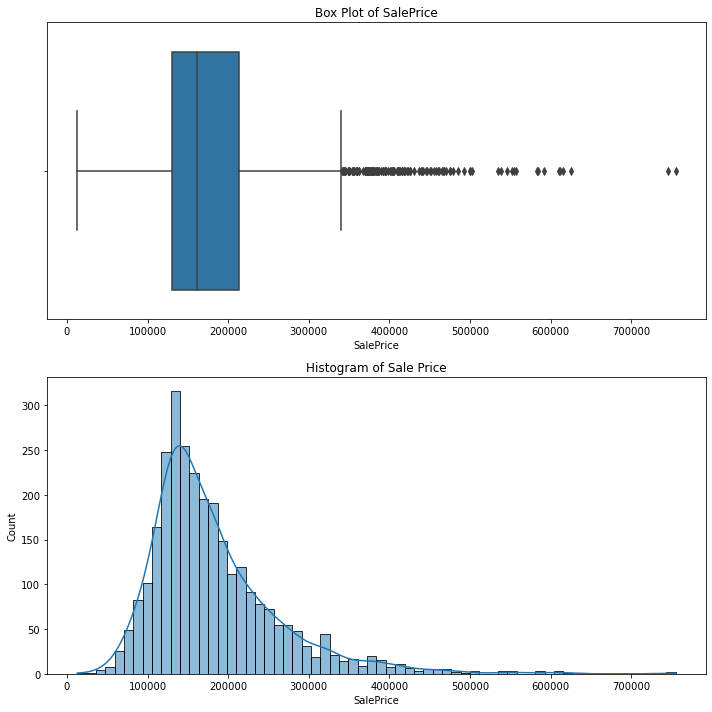

In [436]:
# Set up the figure and axes
fig, ax = plt.subplots(2, 1, figsize=(10, 10))

# Box plot
sns.boxplot(df['SalePrice'], ax=ax[0])
ax[0].set_title('Box Plot of SalePrice')

# Histogram
sns.histplot(df['SalePrice'], kde=True, ax=ax[1])
ax[1].set_title('Histogram of Sale Price')

plt.tight_layout()
plt.show()

Not surprisingly the data is right skewed meaning the mean is higher than the median as there are many homes worth magnitudes more than the median. The mean is $181k per home while the median is $161k per home.

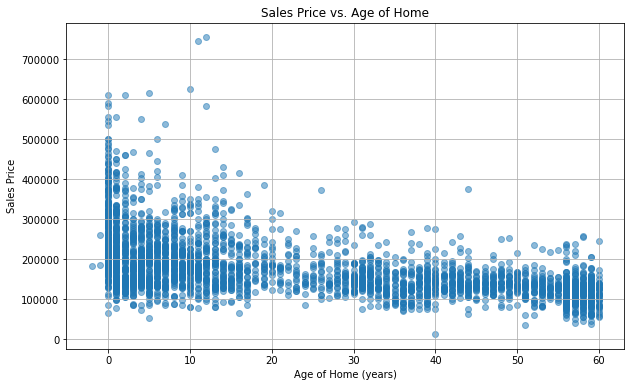

In [437]:
#scatterplot of age of home (or age since remodel)
plt.figure(figsize=(10,6))
plt.scatter(df['Years_Since_Modification'], df['SalePrice'], alpha=0.5)
plt.title('Sales Price vs. Age of Home')
plt.xlabel('Age of Home (years)')
plt.ylabel('Sales Price')
plt.grid(True)
plt.show()

There is a clear trend that the newer the homes are selling for more money. Lets get a closer look in 5 year increments.

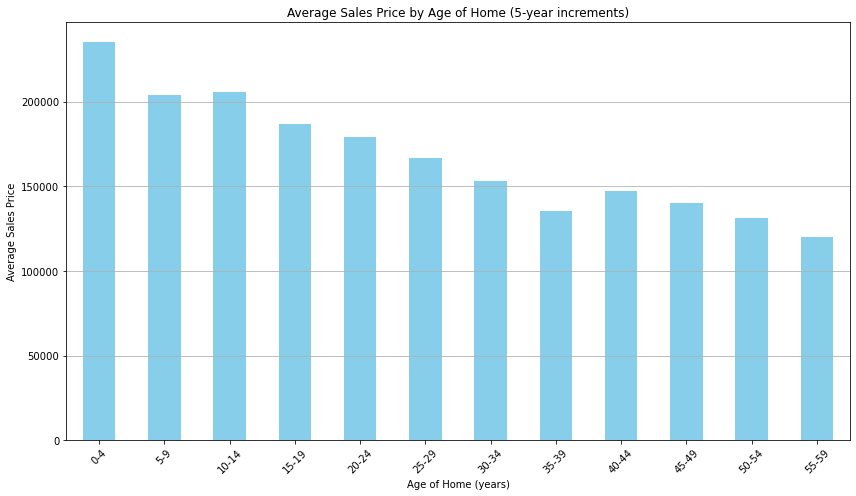

In [438]:
# Bin the age data into 5-year increments
bins = range(0, df['Years_Since_Modification'].max() + 5, 5)
labels = [f"{i}-{i+4}" for i in range(0, df['Years_Since_Modification'].max(), 5)]
df['Age_Bin'] = pd.cut(df['Years_Since_Modification'], bins=bins, labels=labels, right=False)

# Group by age bins and calculate the average sales price
avg_sales = df.groupby('Age_Bin')['SalePrice'].mean()

# Plot
plt.figure(figsize=(12,7))
avg_sales.plot(kind='bar', color='skyblue')
plt.title('Average Sales Price by Age of Home (5-year increments)')
plt.xlabel('Age of Home (years)')
plt.ylabel('Average Sales Price')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.tight_layout()
plt.show()

We have quite a large number of numeric features and not all of them will be relevant to our analysis.  Some data is linear like lot sqft and for this data I will use pearson correlation.  For other data such as quality which is ordinal, I will use spearman correlation.

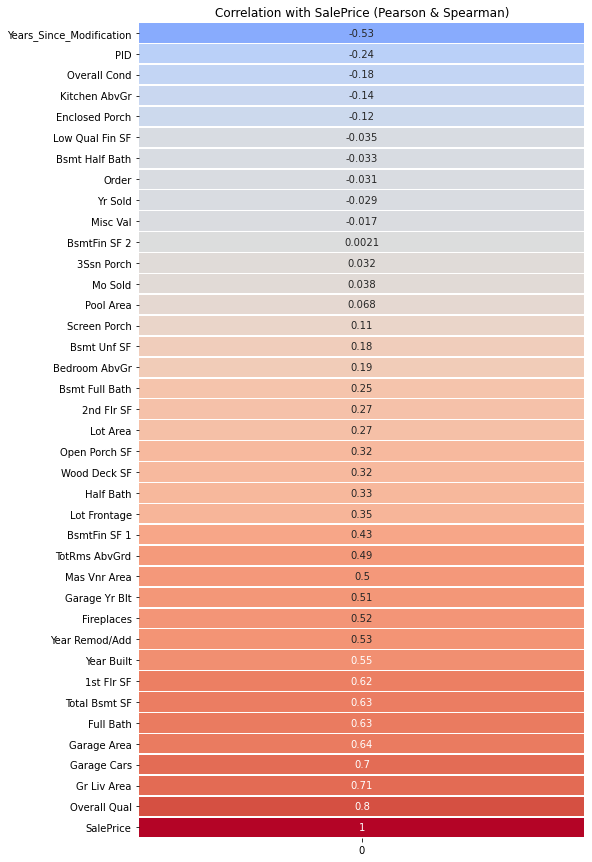

In [439]:
# Select only numeric columns
numeric_df = df.select_dtypes(include=['float64', 'int64'])

# Identify columns with values between 0 and 10 (inclusive) for Spearman correlation
spearman_cols = numeric_df.columns[numeric_df.apply(lambda x: x.between(0, 10).all())].tolist()

# Compute Pearson correlation for most columns with 'SalePrice'
pearson_corr_with_saleprice = numeric_df.drop(columns=spearman_cols).corrwith(df['SalePrice'], method='pearson')

# Compute Spearman correlation for the selected columns with 'SalePrice'
spearman_corr_with_saleprice = numeric_df[spearman_cols].corrwith(df['SalePrice'], method='spearman')

# Combine the correlation results
final_corr_with_saleprice = pd.concat([pearson_corr_with_saleprice, spearman_corr_with_saleprice])

# Plot
plt.figure(figsize=(8, 15))
sns.heatmap(final_corr_with_saleprice.sort_values().to_frame(), annot=True, cmap='coolwarm', cbar=False, center=0, linewidths=0.5)
plt.title('Correlation with SalePrice (Pearson & Spearman)')
plt.show()

We are going to cut down on the features we take into the regression in 2 steps.  First we are going to drop the features with an absolute value < .25 and then drop features with high multicolinearity (VIF above 10).

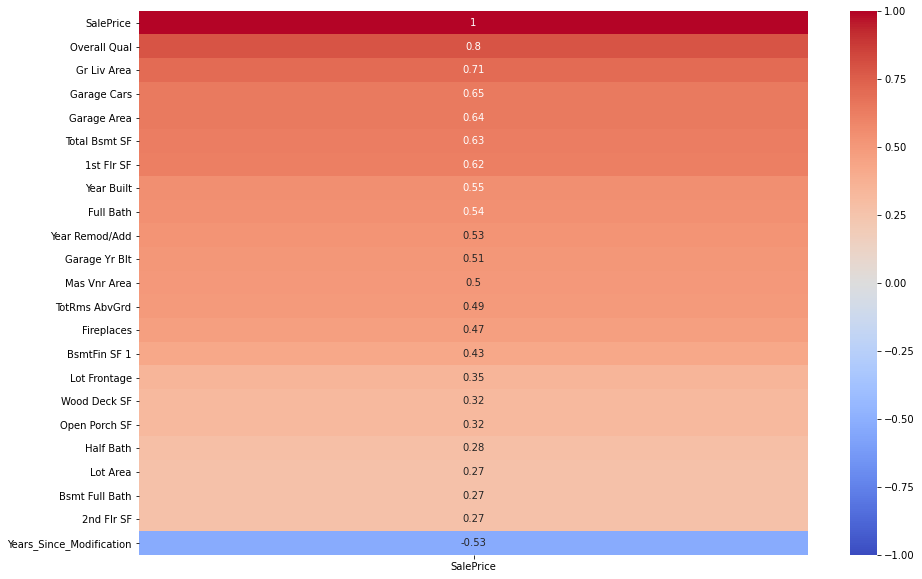

In [440]:
# Identify columns to drop based on final_corr_with_saleprice
cols_to_drop = final_corr_with_saleprice[final_corr_with_saleprice.abs() < 0.25].index

# Drop those indices from the Series
final_corr_with_saleprice = final_corr_with_saleprice.drop(index=cols_to_drop)

# Now, since the heatmap is for the dataframe, and not just the correlations, we need to drop these columns from df as well
numeric_df = numeric_df.drop(columns=cols_to_drop)

# Visualization
plt.figure(figsize=(15, 10))
sns.heatmap(numeric_df.corr()[['SalePrice']].sort_values(by='SalePrice', ascending=False),
            cmap='coolwarm', annot=True, vmin=-1, vmax=1)
plt.show()


In [441]:
# Ensure SalePrice is excluded if it's present
if 'SalePrice' in numeric_df.columns:
    features = numeric_df.drop(['SalePrice'], axis=1)
else:
    features = numeric_df.copy()

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data["Feature"] = features.columns
vif_data["VIF"] = [variance_inflation_factor(features.values, i) for i in range(features.shape[1])]

# Display the initial VIF data
print("Initial VIF Data:")
print(vif_data.sort_values(by="VIF", ascending=False))

Initial VIF Data:
                     Feature     VIF
16             Garage Yr Blt 23056.4
3                 Year Built 17562.6
4             Year Remod/Add 17020.0
10               Gr Liv Area  1288.7
8                 1st Flr SF   797.0
9                 2nd Flr SF   154.0
2               Overall Qual    57.6
14             TotRms AbvGrd    56.8
17               Garage Cars    37.2
18               Garage Area    33.2
7              Total Bsmt SF    24.2
12                 Full Bath    23.6
0               Lot Frontage    16.2
21  Years_Since_Modification     5.0
6               BsmtFin SF 1     4.4
1                   Lot Area     3.4
13                 Half Bath     3.3
11            Bsmt Full Bath     3.0
15                Fireplaces     2.8
5               Mas Vnr Area     1.9
20             Open Porch SF     1.8
19              Wood Deck SF     1.8


In reviewing the VIF we see a few features have quite high multicolinearity which needs to be addressed before a regression can be done. Some of these features are too critical to just drop so we will make some adjustments to see if we can fix without losing the data such as combining columns that don't need to be separated.  We can also drop redudant features like 1st and 2nd floor SF as long as we have gross living area and dropping year built info as long as we have age of home when sold. Also garage area is redundant with Garage cars.

In [442]:
# Combining 'Full Bath' and 'Half Bath' into 'Total Bath'
numeric_df['Total Bath'] = numeric_df['Full Bath'] + 0.5 * numeric_df['Half Bath']
# Dropping specified columns
cols_to_drop = ['TotRms AbvGrd', 'BsmtFin SF 1','Garage Yr Blt', 'Year Built', 'Year Remod/Add', '1st Flr SF', '2nd Flr SF', 'Garage Area', 'Full Bath', 'Half Bath']
numeric_df = numeric_df.drop(cols_to_drop, axis=1)


In [443]:
# Ensure SalePrice is excluded
features_without_target = numeric_df.drop(['SalePrice'], axis=1) if 'SalePrice' in numeric_df.columns else numeric_df

# Recalculate VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_data = pd.DataFrame()
vif_data["Feature"] = features_without_target.columns
vif_data["VIF"] = [variance_inflation_factor(features_without_target.values, i) for i in range(features_without_target.shape[1])]

print(vif_data.sort_values(by="VIF", ascending=False))


                     Feature  VIF
5                Gr Liv Area 29.9
2               Overall Qual 29.8
12                Total Bath 21.5
0               Lot Frontage 13.7
4              Total Bsmt SF 12.4
8                Garage Cars 11.9
1                   Lot Area  3.4
7                 Fireplaces  2.5
11  Years_Since_Modification  2.3
6             Bsmt Full Bath  2.0
9               Wood Deck SF  1.8
10             Open Porch SF  1.8
3               Mas Vnr Area  1.7


Some VIF values are higher than 10 but that is to be expected for data like this which is prone to high multicolinearity.  The aggregiously high values are dealth with.

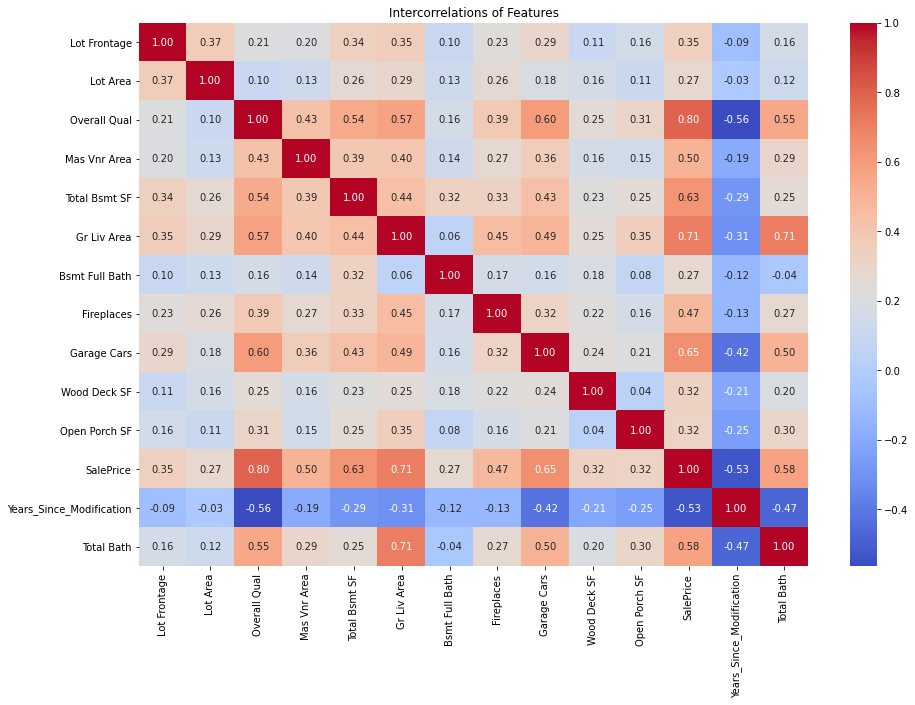

In [444]:
# Calculate the correlation matrix
corr_matrix = numeric_df.corr()

# Visualizing the intercorrelation with a heatmap
plt.figure(figsize=(15, 10))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title('Intercorrelations of Features')
plt.show()


## Categorical Feature Analysis

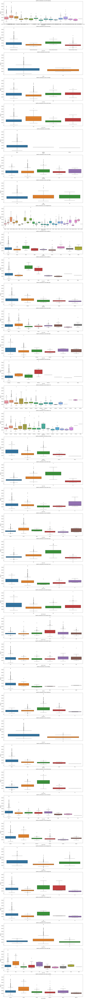

In [445]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming df contains the original data with SalePrice column
categorical_cols = df.select_dtypes(include=['object']).columns

# Setting up the plotting
n_rows = len(categorical_cols)

plt.figure(figsize=(20, 6 * n_rows))

for idx, col in enumerate(categorical_cols, 1):
    plt.subplot(n_rows, 1, idx) # One plot per row
    sns.boxplot(data=df, x=col, y='SalePrice')
    plt.title(f'SalePrice distribution across {col}')
    
    # Annotate the boxplot with counts
    ax = plt.gca()
    for patch in ax.patches:
        x = patch.get_x() + patch.get_width() / 2
        y = patch.get_y() + patch.get_height()
        label = int(patch.get_width())  # count
        ax.text(x, y, f'{label}', ha='center', va='bottom')

    plt.tight_layout()

plt.show()



We are going to select 
LotShape
Condition1
BldgType
HouseStyle
Foundation
BsmtQual
GarageType 
Neighborhood

As the categorical features to move forward with in our analysis based on  variation in price across different values and a reasonable spread of datapoints across different values.

In [446]:
cat_columns = ['Neighborhood', 'Lot Shape', 'Condition 1', 'Bldg Type', 'House Style', 'Foundation', 'Bsmt Qual', 'Garage Type']
cat_df = df[cat_columns].copy()


Lets combine our categorical and numeric predictors and start with our model

In [447]:
# Combine numeric_df and cat_df
combined_df = pd.concat([numeric_df, cat_df], axis=1)

# Display all the predictor columns
print(combined_df.columns)


Index(['Lot Frontage', 'Lot Area', 'Overall Qual', 'Mas Vnr Area',
       'Total Bsmt SF', 'Gr Liv Area', 'Bsmt Full Bath', 'Fireplaces',
       'Garage Cars', 'Wood Deck SF', 'Open Porch SF', 'SalePrice',
       'Years_Since_Modification', 'Total Bath', 'Neighborhood', 'Lot Shape',
       'Condition 1', 'Bldg Type', 'House Style', 'Foundation', 'Bsmt Qual',
       'Garage Type'],
      dtype='object')


## Train and Evaluate Mode to Predict Sale Price

In [448]:
# Identify the indices for train and test data based on 'YrSold' from the original df
train_indices = df[df['Yr Sold'] < 2010].index
test_indices = df[df['Yr Sold'] == 2010].index

# Use these indices to split combined_df
train_data = combined_df.loc[train_indices]
test_data = combined_df.loc[test_indices]

# Extract SalePrice and predictors for train set
X_train = train_data.drop(columns='SalePrice')
y_train = train_data['SalePrice']

# Extract SalePrice and predictors for test set
X_test = test_data.drop(columns='SalePrice')
y_test = test_data['SalePrice']

# Verify the split
print(f"Training data shape: {X_train.shape}")
print(f"Test data shape: {X_test.shape}")


Training data shape: (2565, 21)
Test data shape: (336, 21)


In [449]:
X= combined_df.drop(columns='SalePrice')
y= combined_df['SalePrice']
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2901 entries, 0 to 2929
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Lot Frontage              2901 non-null   float64
 1   Lot Area                  2901 non-null   int64  
 2   Overall Qual              2901 non-null   int64  
 3   Mas Vnr Area              2901 non-null   float64
 4   Total Bsmt SF             2901 non-null   float64
 5   Gr Liv Area               2901 non-null   int64  
 6   Bsmt Full Bath            2901 non-null   float64
 7   Fireplaces                2901 non-null   int64  
 8   Garage Cars               2901 non-null   float64
 9   Wood Deck SF              2901 non-null   int64  
 10  Open Porch SF             2901 non-null   int64  
 11  Years_Since_Modification  2901 non-null   int64  
 12  Total Bath                2901 non-null   float64
 13  Neighborhood              2901 non-null   object 
 14  Lot Shap

In [450]:
# Ensure that all categorical variables are encoded
X_dummy = pd.get_dummies(X, drop_first=True)

# Identify the indices for train and test data based on 'Yr Sold' from the original df
train_indices = df[df['Yr Sold'] < 2010].index
test_indices = df[df['Yr Sold'] == 2010].index

# Use these indices to split the data
X_train = X_dummy.loc[train_indices]
X_test = X_dummy.loc[test_indices]  

# Ensure that y is correctly defined as well
y_train = y.loc[train_indices]
y_test = y.loc[test_indices]

# Initialize the StandardScaler
ss = StandardScaler()

# Fit the scaler to the training data and transform the training data
X_train_ss = ss.fit_transform(X_train)

# Transform the test data using the same scaler
X_test_ss = ss.transform(X_test)

# Display summary statistics for standardized predictor training data
pd.DataFrame(X_train_ss, columns=X_dummy.columns).describe().round(3)



,Lot Frontage,Lot Area,Overall Qual,Mas Vnr Area,Total Bsmt SF,Gr Liv Area,Bsmt Full Bath,Fireplaces,Garage Cars,Wood Deck SF,Open Porch SF,Years_Since_Modification,Total Bath,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_Greens,Neighborhood_GrnHill,Neighborhood_IDOTRR,Neighborhood_Landmrk,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Lot Shape_IR2,Lot Shape_IR3,Lot Shape_Reg,Condition 1_Feedr,Condition 1_Norm,Condition 1_PosA,Condition 1_PosN,Condition 1_RRAe,Condition 1_RRAn,Condition 1_RRNe,Condition 1_RRNn,Bldg Type_2fmCon,Bldg Type_Duplex,Bldg Type_Twnhs,Bldg Type_TwnhsE,House Style_1.5Unf,House Style_1Story,House Style_2.5Fin,House Style_2.5Unf,House Style_2Story,House Style_SFoyer,House Style_SLvl,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,Bsmt Qual_Fa,Bsmt Qual_Gd,Bsmt Qual_TA,Garage Type_Attchd,Garage Type_Basment,Garage Type_BuiltIn,Garage Type_CarPort,Garage Type_Detchd
count,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0,2565.0
mean,0.0,-0.0,-0.0,0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.0,-0.0,0.0,0.0,0.0,-0.0,0.0,-0.0,0.0,-0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,0.0,0.0,0.0,-0.0,0.0,-0.0,-0.0,-0.0,0.0,0.0,-0.0,-0.0,-0.0,0.0,-0.0,0.0,-0.0,-0.0,0.0,-0.0,0.0,0.0,0.0,-0.0,0.0,-0.0,-0.0,-0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0,-0.0,0.0
std,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
min,-2.3,-1.1,-3.7,-0.6,-2.4,-2.3,-0.8,-0.9,-2.4,-0.7,-0.7,-1.2,-2.8,-0.1,-0.1,-0.2,-0.1,-0.3,-0.2,-0.3,-0.2,-0.0,-0.0,-0.2,-0.0,-0.1,-0.2,-0.4,-0.1,-0.2,-0.2,-0.2,-0.3,-0.1,-0.2,-0.2,-0.3,-0.1,-0.2,-0.1,-0.2,-0.1,-1.3,-0.2,-2.5,-0.1,-0.1,-0.1,-0.1,-0.0,-0.1,-0.1,-0.2,-0.2,-0.3,-0.1,-1.0,-0.1,-0.1,-0.7,-0.2,-0.2,-0.8,-0.9,-0.1,-0.0,-0.0,-0.2,-0.9,-0.9,-1.3,-0.1,-0.3,-0.1,-0.6
25%,-0.4,-0.3,-0.8,-0.6,-0.6,-0.7,-0.8,-0.9,-1.0,-0.7,-0.7,-0.9,-1.2,-0.1,-0.1,-0.2,-0.1,-0.3,-0.2,-0.3,-0.2,-0.0,-0.0,-0.2,-0.0,-0.1,-0.2,-0.4,-0.1,-0.2,-0.2,-0.2,-0.3,-0.1,-0.2,-0.2,-0.3,-0.1,-0.2,-0.1,-0.2,-0.1,-1.3,-0.2,0.4,-0.1,-0.1,-0.1,-0.1,-0.0,-0.1,-0.1,-0.2,-0.2,-0.3,-0.1,-1.0,-0.1,-0.1,-0.7,-0.2,-0.2,-0.8,-0.9,-0.1,-0.0,-0.0,-0.2,-0.9,-0.9,-1.3,-0.1,-0.3,-0.1,-0.6
50%,-0.0,-0.1,-0.1,-0.6,-0.1,-0.1,-0.8,0.6,0.3,-0.7,-0.3,-0.4,0.4,-0.1,-0.1,-0.2,-0.1,-0.3,-0.2,-0.3,-0.2,-0.0,-0.0,-0.2,-0.0,-0.1,-0.2,-0.4,-0.1,-0.2,-0.2,-0.2,-0.3,-0.1,-0.2,-0.2,-0.3,-0.1,-0.2,-0.1,-0.2,-0.1,0.8,-0.2,0.4,-0.1,-0.1,-0.1,-0.1,-0.0,-0.1,-0.1,-0.2,-0.2,-0.3,-0.1,1.0,-0.1,-0.1,-0.7,-0.2,-0.2,-0.8,-0.9,-0.1,-0.0,-0.0,-0.2,-0.9,-0.9,0.7,-0.1,-0.3,-0.1,-0.6
75%,0.4,0.2,0.6,0.3,0.6,0.5,1.1,0.6,0.3,0.6,0.3,0.9,1.1,-0.1,-0.1,-0.2,-0.1,-0.3,-0.2,-0.3,-0.2,-0.0,-0.0,-0.2,-0.0,-0.1,-0.2,-0.4,-0.1,-0.2,-0.2,-0.2,-0.3,-0.1,-0.2,-0.2,-0.3,-0.1,-0.2,-0.1,-0.2,-0.1,0.8,-0.2,0.4,-0.1,-0.1,-0.1,-0.1,-0.0,-0.1,-0.1,-0.2,-0.2,-0.3,-0.1,1.0,-0.1,-0.1,1.5,-0.2,-0.2,1.2,1.1,-0.1,-0.0,-0.0,-0.2,1.2,1.1,0.7,-0.1,-0.3,-0.1,1.7
max,11.4,25

The mean and std for the scaled data is 0 and 1 respectively which is always the goal when standardizing.

In [451]:
# Display summary statistics for standardised predictor test data
pd.DataFrame(X_test_ss, columns=X_dummy.columns).describe()

,Lot Frontage,Lot Area,Overall Qual,Mas Vnr Area,Total Bsmt SF,Gr Liv Area,Bsmt Full Bath,Fireplaces,Garage Cars,Wood Deck SF,Open Porch SF,Years_Since_Modification,Total Bath,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_Greens,Neighborhood_GrnHill,Neighborhood_IDOTRR,Neighborhood_Landmrk,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Lot Shape_IR2,Lot Shape_IR3,Lot Shape_Reg,Condition 1_Feedr,Condition 1_Norm,Condition 1_PosA,Condition 1_PosN,Condition 1_RRAe,Condition 1_RRAn,Condition 1_RRNe,Condition 1_RRNn,Bldg Type_2fmCon,Bldg Type_Duplex,Bldg Type_Twnhs,Bldg Type_TwnhsE,House Style_1.5Unf,House Style_1Story,House Style_2.5Fin,House Style_2.5Unf,House Style_2Story,House Style_SFoyer,House Style_SLvl,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,Bsmt Qual_Fa,Bsmt Qual_Gd,Bsmt Qual_TA,Garage Type_Attchd,Garage Type_Basment,Garage Type_BuiltIn,Garage Type_CarPort,Garage Type_Detchd
count,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0,336.0
mean,-0.0,-0.1,-0.1,-0.1,-0.0,-0.1,0.1,-0.1,-0.1,0.1,-0.1,0.1,-0.1,0.1,-0.0,-0.0,0.1,-0.1,-0.1,0.0,-0.1,0.1,-0.0,-0.1,-0.0,0.1,0.1,0.1,0.1,-0.1,0.0,-0.1,0.0,0.1,0.1,0.1,-0.0,0.0,-0.0,-0.1,-0.0,-0.1,0.1,0.0,-0.0,0.0,-0.0,-0.0,-0.1,0.1,-0.0,0.1,0.0,0.0,0.1,-0.1,0.0,-0.1,-0.1,-0.0,-0.0,-0.0,0.1,-0.1,-0.0,0.1,0.0,0.0,-0.0,0.1,0.0,0.0,-0.1,-0.0,0.0
std,1.0,0.7,1.0,0.9,0.9,0.9,1.0,1.0,1.0,1.1,0.8,1.0,1.0,1.4,0.9,0.9,1.3,0.8,0.8,1.0,0.9,1.6,0.0,0.8,0.0,1.3,1.2,1.1,1.3,0.8,1.1,0.9,1.0,1.4,1.2,1.1,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,1.2,0.8,1.0,0.4,2.0,1.0,1.2,1.1,1.1,1.1,0.0,1.0,0.0,0.6,1.0,1.0,0.9,1.0,1.0,0.8,1.6,1.4,1.1,1.0,1.0,1.0,1.1,0.8,0.8,1.0
min,-2.3,-1.1,-3.0,-0.6,-2.4,-1.9,-0.8,-0.9,-2.4,-0.7,-0.7,-1.1,-2.8,-0.1,-0.1,-0.2,-0.1,-0.3,-0.2,-0.3,-0.2,-0.0,-0.0,-0.2,-0.0,-0.1,-0.2,-0.4,-0.1,-0.2,-0.2,-0.3,-0.3,-0.1,-0.2,-0.2,-0.3,-0.1,-0.2,-0.1,-0.2,-0.1,-1.3,-0.2,-2.5,-0.1,-0.1,-0.1,-0.1,-0.0,-0.1,-0.1,-0.2,-0.2,-0.3,-0.1,-1.0,-0.1,-0.1,-0.7,-0.2,-0.2,-0.8,-0.9,-0.1,-0.0,-0.0,-0.2,-0.9,-0.9,-1.3,-0.1,-0.3,-0.1,-0.6
25%,-0.4,-0.3,-0.8,-0.6,-0.6,-0.8,-0.8,-0.9,-1.0,-0.7,-0.7,-0.8,-1.2,-0.1,-0.1,-0.2,-0.1,-0.3,-0.2,-0.3,-0.2,-0.0,-0.0,-0.2,-0.0,-0.1,-0.2,-0.4,-0.1,-0.2,-0.2,-0.3,-0.3,-0.1,-0.2,-0.2,-0.3,-0.1,-0.2,-0.1,-0.2,-0.1,-1.3,-0.2,0.4,-0.1,-0.1,-0.1,-0.1,-0.0,-0.1,-0.1,-0.2,-0.2,-0.3,-0.1,-1.0,-0.1,-0.1,-0.7,-0.2,-0.2,-0.8,-0.9,-0.1,-0.0,-0.0,-0.2,-0.9,-0.9,-1.3,-0.1,-0.3,-0.1,-0.6
50%,-0.0,-0.1,-0.1,-0.6,-0.1,-0.2,-0.8,-0.9,0.3,-0.7,-0.7,-0.2,0.4,-0.1,-0.1,-0.2,-0.1,-0.3,-0.2,-0.3,-0.2,-0.0,-0.0,-0.2,-0.0,-0.1,-0.2,-0.4,-0.1,-0.2,-0.2,-0.3,-0.3,-0.1,-0.2,-0.2,-0.3,-0.1,-0.2,-0.1,-0.2,-0.1,0.8,-0.2,0.4,-0.1,-0.1,-0.1,-0.1,-0.0,-0.1,-0.1,-0.2,-0.2,-0.3,-0.1,1.0,-0.1,-0.1,-0.7,-0.2,-0.2,-0.8,-0.9,-0.1,-0.0,-0.0,-0.2,-0.9,-0.9,0.7,-0.1,-0.3,-0.1,-0.6
75%,0.5,0.1,0.6,0.1,0.5,0.4,1.1,0.6,0.3,0.7,0.2,1.0,0.4,-0.1,-0.1,-0.2,-0.1,-0.3,-0.2,-0.3,-0.2,-0.0,-0.0,-0.2,-0.0,-0.1,-0.2,-0.4,-0.1,-0.2,-0.2,-0.3,-0.3,-0.1,-0.2,-0.2,-0.3,-0.1,-0.2,-0.1,-0.2,-0.1,0.8,-0.2,0.4,-0.1,-0.1,-0.1,-0.1,-0.0,-0.1,-0.1,-0.2,-0.2,-0.3,-0.1,1.0,-0.1,-0.1,1.5,-0.2,-0.2,1.2,1.1,-0.1,-0.0,-0.0,-0.2,1.2,1.1,0.7,-0.1,-0.3,-0.1,1.7
max,3.9,5.8,2.0,5.8,4.0,3.5,3.0,2.2,2.9,4.6,3.9,1.8,5.0,17.9,9.7,5.0,8.4,3.1,

The test data isn't quite as flawless but everything is within range.

### R2 Score

We are going to start scoring our model with R2 and then RMSE

In [452]:
# Fit Linear Regression model on training data and evaluate on test data
lnr = LinearRegression()
lnr.fit(X_train_ss, y_train)
print(f'R2 score on training data: {round(lnr.score(X_train_ss, y_train),3)}')
print(f'R2 score on test data: {round(lnr.score(X_test_ss, y_test),3)}')

R2 score on training data: 0.87
R2 score on test data: 0.867


The model has a testing R2 score of .867 which means that our model and predictors explain 86.7% of the variance in the data which is fairly strong.

In [453]:
# Print baseline prediction
print(f'Baseline prediction: ${round(np.mean(y_test))}')
# Look at model intercept and range of coefficients
print(f'Intercept: ${lnr.intercept_}')
print(f'\nRange of Coefficients: {[min(lnr.coef_), max(lnr.coef_)]}')

Baseline prediction: $174063.0
Intercept: $182844.93177387913

Range of Coefficients: [-20247.362474068745, 23305.622436180893]


The baseline prediction of a price of a home is 174k ie the average price of a home in the test data.  The intercept is $ 183k ie the price of a home when all of the predictors are at their respective average values.

### RMSE

In [454]:
# Calculate RMSE
predictions = lnr.predict(X_test_ss)

print(f'Root Mean Square Error of model on test data is: \
${int(mean_squared_error(y_test, predictions)**0.5)}')

print(f'Root Mean Square Error of model on train data is: \
${int(mean_squared_error(y_train, lnr.predict(X_train_ss))**0.5)}')

Root Mean Square Error of model on test data is: $27022
Root Mean Square Error of model on train data is: $28931


The RMSE on the test data is 27,022 which means that our models predictions of a house price will typically be within 27,000 dollars.

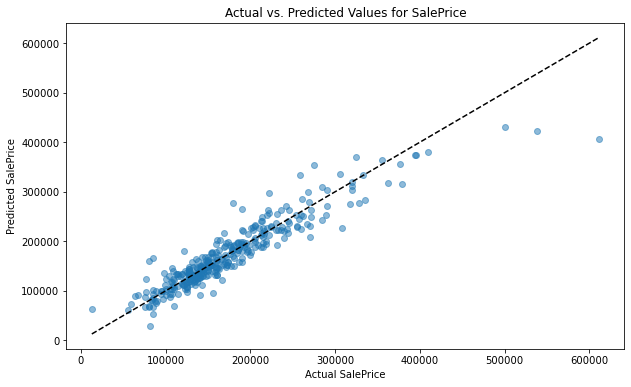

In [455]:
# Initialize the Linear Regression model
linear_model = LinearRegression()

# Fit the model with your training data
linear_model.fit(X_train_ss, y_train)

# Predict using the model on the test data
y_pred = linear_model.predict(X_test_ss)

# Scatter plot of actual vs. predicted values
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.title('Actual vs. Predicted Values for SalePrice')
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], 'k--')  # Diagonal line
plt.show()


Now that we have our baseline regression model with its R2 and RMSE lets see we if we can improve performance with regularization.

### Regularization Techniques



#### Lasso Regresssion

In [456]:
from sklearn.linear_model import Lasso

# Initialize Lasso regression with an alpha value
lasso_model = Lasso(alpha=0.001)  # Try different values of alpha

# Fit the model with your training data
lasso_model.fit(X_train_ss, y_train)

# Predict using the model on the test data
y_pred_lasso = lasso_model.predict(X_test_ss)

# Calculate metrics
lasso_rmse = mean_squared_error(y_test, y_pred_lasso, squared=False)
lasso_r2 = r2_score(y_test, y_pred_lasso)

print("Lasso RMSE:", lasso_rmse)
print("Lasso R^2:", lasso_r2)


Lasso RMSE: 27022.132471944125
Lasso R^2: 0.8668354635925131


In [457]:
#Lasso with GridSearchCV
# Define a dictionary for the parameter 'alpha' with a range of values to test
param_grid_lasso = {'alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10]}

# Initialize Lasso regression
lasso = Lasso()

# Initialize GridSearchCV
lasso_cv = GridSearchCV(lasso, param_grid_lasso, scoring='neg_mean_squared_error', cv=5)

# Fit the model with your scaled training data
lasso_cv.fit(X_train_ss, y_train)

# Print the best parameter and the best RMSE score
print("Best parameter: ", lasso_cv.best_params_)
print("Best RMSE: ", (-lasso_cv.best_score_)**0.5)

# Predict using the best model on the test data
y_pred_lasso = lasso_cv.predict(X_test_ss)

# Calculate metrics
lasso_rmse = mean_squared_error(y_test, y_pred_lasso, squared=False)
lasso_r2 = r2_score(y_test, y_pred_lasso)

print("Lasso Test RMSE:", lasso_rmse)
print("Lasso Test R^2:", lasso_r2)


C:\Users\jakes\anaconda3\envs\learn-env\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:529: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 83606765335.36304, tolerance: 1398049548.2622614
  model = cd_fast.enet_coordinate_descent(
C:\Users\jakes\anaconda3\envs\learn-env\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:529: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1576428704.2443848, tolerance: 1398049548.2622614
  model = cd_fast.enet_coordinate_descent(


Best parameter:  {'alpha': 10}
Best RMSE:  30777.452288282486
Lasso Test RMSE: 27007.58623822223
Lasso Test R^2: 0.8669787921110303


#### Ridge Regression

In [458]:
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error, r2_score

# Initialize Ridge regression with an alpha value
ridge_model = Ridge(alpha=1.0)  # Try different values of alpha

# Fit the model with your training data
ridge_model.fit(X_train_ss, y_train)

# Predict using the model on the test data
y_pred_ridge = ridge_model.predict(X_test_ss)

# Calculate metrics
ridge_rmse = mean_squared_error(y_test, y_pred_ridge, squared=False)
ridge_r2 = r2_score(y_test, y_pred_ridge)

print("Ridge RMSE:", ridge_rmse)
print("Ridge R^2:", ridge_r2)


Ridge RMSE: 27020.18916939828
Ridge R^2: 0.8668546160171273


In [459]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score

# Define a dictionary for the parameter 'alpha' with a range of values to test
param_grid = {'alpha': [0.001, 0.01, 0.1, 1, 10, 100]}

# Initialize Ridge regression
ridge = Ridge()

# Initialize GridSearchCV
ridge_cv = GridSearchCV(ridge, param_grid, scoring='neg_mean_squared_error', cv=5)

# Fit the model with your scaled training data
ridge_cv.fit(X_train_ss, y_train)

# Print the best parameter and the best RMSE score
print("Best parameter: ", ridge_cv.best_params_)
print("Best RMSE: ", (-ridge_cv.best_score_)**0.5)

# Predict using the best model on the test data
y_pred_ridge = ridge_cv.predict(X_test_ss)

# Calculate metrics
ridge_rmse = mean_squared_error(y_test, y_pred_ridge, squared=False)
ridge_r2 = r2_score(y_test, y_pred_ridge)

print("Ridge Test RMSE:", ridge_rmse)
print("Ridge Test R^2:", ridge_r2)


Best parameter:  {'alpha': 10}
Best RMSE:  30747.486883867543
Ridge Test RMSE: 27006.612779067094
Ridge Test R^2: 0.866988381148557


There is negligable improvement on our models after regularization. Lets check coeficients to see to measure feature impact.  We will use the lasso model for this.

In [460]:
# Initialize the Lasso model with a certain alpha value
lasso = Lasso(alpha=0.001)  # Adjust alpha as needed

# Fit the model to the training data
lasso.fit(X_train_ss, y_train)

# Retrieve the coefficients
lasso_coef = lasso.coef_

# Feature names from the DataFrame
feature_names = X_dummy.columns  # X_dummy being the DataFrame of features after encoding

# Create a DataFrame of features and their corresponding coefficients
feature_importance = pd.DataFrame({
    'Feature': feature_names,
    'Coefficient': lasso_coef
})

# Calculate the absolute value of coefficients to determine the importance
feature_importance['Absolute_Coefficient'] = feature_importance['Coefficient'].abs()

# Sort by the absolute coefficient to rank the features
feature_importance_sorted = feature_importance.sort_values(by='Absolute_Coefficient', ascending=False)

# Display the ranked features
print(feature_importance_sorted)


                     Feature  Coefficient  Absolute_Coefficient
5                Gr Liv Area      23305.6               23305.6
69              Bsmt Qual_TA     -20247.4               20247.4
68              Bsmt Qual_Gd     -19873.4               19873.4
2               Overall Qual      18146.9               18146.9
54          Bldg Type_TwnhsE      -8409.4                8409.4
53           Bldg Type_Twnhs      -7677.6                7677.6
31      Neighborhood_NridgHt       7161.8                7161.8
67              Bsmt Qual_Fa      -6989.4                6989.4
6             Bsmt Full Bath       6831.6                6831.6
32      Neighborhood_OldTown      -6781.8                6781.8
27        Neighborhood_NAmes      -6736.4                6736.4
19      Neighborhood_Edwards      -6541.7                6541.7
11  Years_Since_Modification      -6477.5                6477.5
8                Garage Cars       5974.0                5974.0
37      Neighborhood_StoneBr       5667.

The numeric predictors with the higher impact on SalesPrice are the gross living area and the overall quality which isn't a surprise.

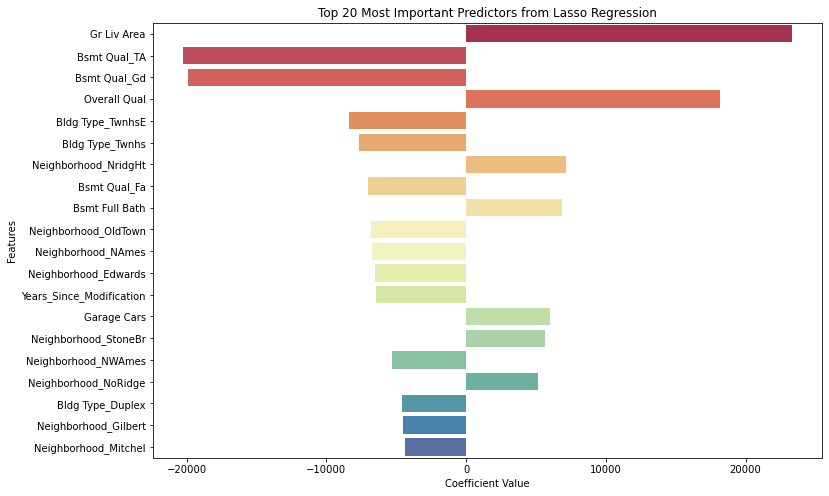

In [461]:
import seaborn as sns

# Sort the values to get the most important features at the top, keeping their signs
sorted_coefs = coefs_series.sort_values(key=abs, ascending=False)

# Select the top 20 most important features
top_20_features = sorted_coefs.head(20)

# Plotting the top 20 features with colors
plt.figure(figsize=(12, 8))
sns.barplot(x=top_20_features.values, y=top_20_features.index, palette='Spectral')

plt.title('Top 20 Most Important Predictors from Lasso Regression')
plt.xlabel('Coefficient Value')
plt.ylabel('Features')

# This will add the exact value on each bar
for index, value in enumerate(top_20_features):
    plt.show()




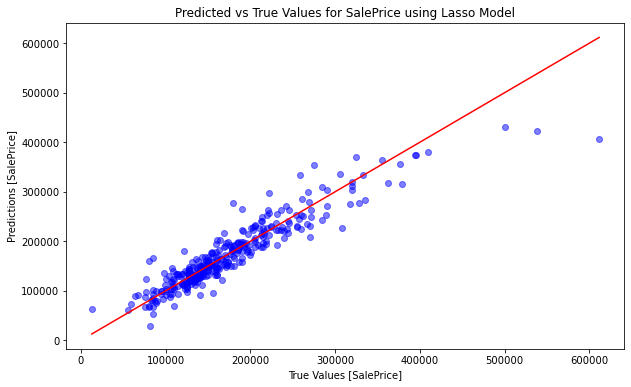

In [462]:
# Fit the model on training data
lasso_model.fit(X_train_ss, y_train)

# Predict on test data
y_pred = lasso_model.predict(X_test_ss)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.5, color='blue')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red') # Line for perfect predictions
plt.xlabel('True Values [SalePrice]')
plt.ylabel('Predictions [SalePrice]')
plt.title('Predicted vs True Values for SalePrice using Lasso Model')
plt.show()

Regularization didn't improve our model quality but it is still fairly strong as most predictions are close to the true value except for a few data points for the more expensive units where there is less data.

## Taking Action

Now that we see which features are most critical to price predicatabiliy, we need to gather actionable stats for developers to use to optimize their chances at making a profit.  We see that Gross living area is the strongest predictor of price but often times due to zoning a house cannot be expanded so for the sake of this exercise we will assume that is not possible. The next biggest features are basement quality and overall quality followed by various building types and neighborhoods.  We will look to answer in which neighborhoods, building types within those neighborhoods, and more specifically which BSMT quality and overall quality we should target for renovation.

In [463]:
# Filter the columns we are interested in
columns_of_interest = ['Bsmt Qual', 'Neighborhood', 'Overall Qual', 'Bldg Type', 'SalePrice']
refined_df = df[columns_of_interest]

# Now show describe information for each of these columns against SalePrice
for col in columns_of_interest[:-1]:  # Exclude 'SalePrice' itself
    print(f"Descriptive statistics for {col} against SalePrice:")
    print(refined_df.groupby(col)['SalePrice'].describe())
    print("\n")



Descriptive statistics for Bsmt Qual against SalePrice:
           count     mean      std      min      25%      50%      75%  \
Bsmt Qual                                                                
Ex         258.0 333369.3 105075.0 100000.0 269625.0 320000.0 386812.5   
Fa          85.0 111304.7  37837.8  12789.0  87500.0 107400.0 129400.0   
Gd        1219.0 201726.8  56611.3  70000.0 163995.0 192000.0 232649.0   
TA        1339.0 138989.7  40579.1  35000.0 115750.0 135000.0 156000.0   

               max  
Bsmt Qual           
Ex        755000.0  
Fa        240000.0  
Gd        538000.0  
TA        475000.0  


Descriptive statistics for Neighborhood against SalePrice:
              count     mean      std      min      25%      50%      75%  \
Neighborhood                                                                
Blmngtn        28.0 196661.7  29317.5 156820.0 175425.0 191500.0 216247.5   
Blueste        10.0 143590.0  30158.5 115000.0 121725.0 130500.0 159625.0   
BrDa

Some of these columns have too few data points. Lets drop all data with less than a 10 count and then check average SalePrice.

In [466]:
# Filter and sort each categorical column by the mean SalePrice and filter out groups with counts less than 10
for col in columns_of_interest[:-1]:  # Exclude 'SalePrice' itself
    group_stats = refined_df.groupby(col)['SalePrice'].agg(['count', 'mean']).reset_index()
    filtered_group_stats = group_stats[group_stats['count'] >= 10].sort_values(by='mean', ascending=False)
    print(f"Sorted descriptive statistics for {col} by mean SalePrice with count >= 10:")
    print(filtered_group_stats)
    print("\n")


Sorted descriptive statistics for Bsmt Qual by mean SalePrice with count >= 10:
  Bsmt Qual  count     mean
0        Ex    258 333369.3
2        Gd   1219 201726.8
3        TA   1339 138989.7
1        Fa     85 111304.7


Sorted descriptive statistics for Neighborhood by mean SalePrice with count >= 10:
   Neighborhood  count     mean
18      NoRidge     71 330319.1
25      StoneBr     51 324229.2
19      NridgHt    166 322018.3
27      Veenker     24 248314.6
26       Timber     72 246599.5
24      Somerst    182 229707.3
4       ClearCr     44 208662.1
6       Crawfor    103 207550.8
5       CollgCr    267 201803.4
0       Blmngtn     28 196661.7
8       Gilbert    165 190646.6
17       NWAmes    131 188406.9
23      SawyerW    125 184070.2
14      Mitchel    113 162941.0
15        NAmes    443 145097.3
1       Blueste     10 143590.0
16      NPkVill     23 140710.9
22       Sawyer    151 136751.2
21        SWISU     47 135959.2
7       Edwards    194 130843.4
3       BrkSide    108 

Showing the power of these predictors, Overall Qual and Bsmt Qual have the highest average SalesPrice in perfect order.  We are going to change the Bsmt Qual to a numeric scale and evaluate the incremental price difference of Bsmt Qual and Overall Qual in each neighborhood and Bldg Type.

Below is the average SalePrice for every unique combination of Bsmt Qual, Overall Qual, Neighborhood, and Bldg Type.

In [468]:
# Map 'Bsmt Qual' to numeric values
quality_mapping = {'Ex': 5, 'Gd': 4, 'TA': 3, 'Fa': 2, 'Po': 1, 'NA': 0}
df['Bsmt Qual Numeric'] = df['Bsmt Qual'].map(quality_mapping)

In [469]:
df['Bsmt Qual Numeric'].value_counts()

3    1339
4    1219
5     258
2      85
Name: Bsmt Qual Numeric, dtype: int64

Lets take a look at the highest average SalesPrice for each combination.

In [475]:
# Selecting the necessary columns for X_refined
X_refined = df[['Bsmt Qual', 'Overall Qual', 'Neighborhood', 'Bldg Type', 'SalePrice']]

# Analyzing the 'SalePrice' against 'Bsmt Qual', 'Overall Qual', 'Neighborhood', 'Bldg Type'
# We will group by these categories and see the mean SalePrice and the count
grouped_data = X_refined.groupby(['Bsmt Qual', 'Overall Qual', 'Neighborhood', 'Bldg Type']) \
                         .agg({'SalePrice': ['mean', 'count']}) \
                         .reset_index()

# Flatten the column headings
grouped_data.columns = [' '.join(col).strip() for col in grouped_data.columns.values]

# Filter out groups with less than 10 observations
grouped_data_filtered = grouped_data[grouped_data['SalePrice count'] >= 10]

# Sort by mean SalePrice
grouped_data_sorted = grouped_data_filtered.sort_values(by='SalePrice mean', ascending=False)

# Show the sorted, filtered dataframe
print(grouped_data_sorted)


    Bsmt Qual  Overall Qual Neighborhood Bldg Type  SalePrice mean  \
50         Ex            10      NridgHt      1Fam        471187.7   
44         Ex             9      StoneBr      1Fam        449377.2   
40         Ex             9      NridgHt      1Fam        393772.9   
30         Ex             8      NridgHt      1Fam        330435.9   
214        Gd             8      NoRidge      1Fam        317948.7   
41         Ex             9      NridgHt    TwnhsE        307751.0   
32         Ex             8      Somerst      1Fam        289071.4   
25         Ex             8      CollgCr      1Fam        285716.3   
35         Ex             8       Timber      1Fam        285236.3   
215        Gd             8      NridgHt      1Fam        283520.4   
188        Gd             7      NoRidge      1Fam        264652.5   
224        Gd             8       Timber      1Fam        262333.8   
205        Gd             8      CollgCr      1Fam        251855.1   
173        Gd       

1Fam in the neighborhood NridgeHt that have the highest bsmt qual and overall qual have the highest average SalePrice. Now lets see which areas and building types have the highest coefficients for.

In [501]:
import pandas as pd
import statsmodels.api as sm

# Initialize an empty list to collect results
results = []

# Get the list of building types from dummy variable columns
bldg_types = [col for col in X_refined.columns if col.startswith('BldgType')]

# Loop through each combination of neighborhood and building type
for neighborhood in X_refined['Neighborhood'].unique():
    for bldg_type in bldg_types:
        # Filter the data for the current neighborhood and building type
        subset = X_refined[(X_refined['Neighborhood'] == neighborhood) & (X_refined[bldg_type] == 1)]
        
        if subset.shape[0] > 10:  # Proceed if there are more than 10 data points
            # Set up the features and target variable
            X = subset[['Bsmt Qual Numeric', 'Overall Qual']]
            y = subset['SalePrice']
            
            # Add a constant to the features for the intercept
            X = sm.add_constant(X)
            
            # Fit the OLS model
            model = sm.OLS(y, X).fit()
            
            # Append the results to the results list, checking if 'const' is in the model params
            result = {
                'Neighborhood': neighborhood,
                'BldgType': bldg_type.replace('BldgType_', ''),  # Strip the prefix to get the building type
                'BsmtQual Coef': model.params.get('Bsmt Qual Numeric', float('nan')),
                'OverallQual Coef': model.params.get('Overall Qual', float('nan')),
                'BsmtQual P-Value': model.pvalues.get('Bsmt Qual Numeric', float('nan')),
                'OverallQual P-Value': model.pvalues.get('Overall Qual', float('nan')),
                'R-squared': model.rsquared
            }
            if 'const' in model.params.index:
                result['Intercept'] = model.params['const']
            else:
                result['Intercept'] = float('nan')  # If no constant was included, set to NaN

            results.append(result)

# Convert the results list to a DataFrame
results_df = pd.DataFrame(results)

# Confirm R-squared is included
if 'R-squared' in results_df.columns:
    # Sort results by R-squared value to see the best fitting models
    results_df.sort_values(by='R-squared', ascending=False, inplace=True)
else:
    print("R-squared is not in the DataFrame columns. Check the regression results.")

# Reset index
results_df.reset_index(drop=True, inplace=True)

# Display the results
print(results_df)



   Neighborhood BldgType  BsmtQual Coef  OverallQual Coef  BsmtQual P-Value  \
0       SawyerW   Duplex        28217.0           43311.6               0.0   
1       MeadowV   TwnhsE        -6705.6           38731.5               0.4   
2       NridgHt   TwnhsE        44216.0           28344.8               0.0   
3       StoneBr   TwnhsE       132373.9          -14983.6               0.0   
4       CollgCr     1Fam        22356.3           35361.4               0.0   
5       Somerst   TwnhsE        43508.2           33853.7               0.0   
6       NoRidge     1Fam        44900.3           84380.6               0.1   
7        Timber     1Fam         7254.2           42932.9               0.5   
8       Mitchel     1Fam        16899.1           26180.7               0.0   
9         NAmes   Duplex         2433.5           26758.3               0.8   
10      NridgHt     1Fam        44373.3           64012.7               0.0   
11      ClearCr     1Fam        27314.2           27

The above are the results for our regression. Now lets sort by Overal Qual Coef.

In [502]:
# Assuming results_df is your DataFrame containing the regression results

# Sort results by OverallQual Coef
sorted_results_df = results_df.sort_values(by='OverallQual Coef', ascending=False)

# Reset index after sorting
sorted_results_df.reset_index(drop=True, inplace=True)

# Display the sorted results
print(sorted_results_df)


   Neighborhood BldgType  BsmtQual Coef  OverallQual Coef  BsmtQual P-Value  \
0       NoRidge     1Fam        44900.3           84380.6               0.1   
1       StoneBr     1Fam        37411.7           70974.6               0.3   
2       NridgHt     1Fam        44373.3           64012.7               0.0   
3       SawyerW   Duplex        28217.0           43311.6               0.0   
4        Timber     1Fam         7254.2           42932.9               0.5   
5       MeadowV   TwnhsE        -6705.6           38731.5               0.4   
6       CollgCr     1Fam        22356.3           35361.4               0.0   
7       Somerst   TwnhsE        43508.2           33853.7               0.0   
8       SawyerW     1Fam        18237.4           32811.7               0.1   
9       Crawfor     1Fam        21291.7           32577.9               0.0   
10      Blmngtn   TwnhsE       -11844.1           29320.6               0.6   
11      NridgHt   TwnhsE        44216.0           28

1Fam buildings in NoRidge have a overal quaility coefficient 84380 which means that every incremental value of increase in overall quality will correspond on average to a $ 84380 increase in sale price.

With the exception of the top Bsmt qual coefficient which seems to be an outlier, improving a basement is not as impactful as improving the overall quality in terms of the highest performers.

In [506]:
# Create dummy variables for the 'Neighborhood'
neighborhood_dummies = pd.get_dummies(df['Neighborhood'], prefix='Neighborhood')

# Concatenate the dummy variables with 'X_refined'
# Make sure 'X_refined' does not have the original 'Neighborhood' column
X_refined = pd.concat([X_refined.drop('Neighborhood', axis=1, errors='ignore'), neighborhood_dummies], axis=1)

# Separate the features and target variable
X = X_refined.drop('SalePrice', axis=1)
y = X_refined['SalePrice']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

# Initialize the RidgeCV model with internal cross-validation
ridge_model = RidgeCV(alphas=np.logspace(-6, 6, 13), scoring='neg_mean_squared_error')

# Fit the RidgeCV model on the training data
ridge_model.fit(X_train, y_train)

# Predict on the test set
y_pred = ridge_model.predict(X_test)

# Calculate the metrics on the test set
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print(f'Test RMSE: {rmse:.2f}')
print(f'Test R²: {r2:.2f}')


Test RMSE: 37225.25
Test R²: 0.77


## Conclusion

This has been alot, lets break it down.  We initially looked at with our first regression models were the key predictors for SalePrice and ultimately learned that they were gross living space, basement quality, overal quality, and then neighborhood and building type.  The simple takeaway for a developer would be simply the more you improve a space the more money a home sells for.  But this is obvious and not exactly actionable. 

What we did next was use the most important predictors to indicate which type of neighborhood a developer should look in and more specifically which type of home within that neighborhood.  From there we built another regression model to quantify how much each increment of overall quality would be worth to the sales price. Our best performing aka highest leverage type of home to renovate was the 1Fam residence in NoRidge which showed an 84k improvement in price for each unit of overall condition improved.  The top 3 were all 1Fam residences in NoRidge, StoneBr, and NRidgeHt all with p-values of 0 which means the predictor is statistically significant ie these results cannot be from chance. 

Our latest model had an RMSE of 37210 and an R2 score of .77 which means the predicted value on average will be within 37k dollars of the actual value and our model can explain 77% of variance.  This score is not as strong as our initial regression that used all the key predictors which had an RMSE of 27000 and R2 of .87 which means the predictors we initially used were actually critical in improving our model's accuracy.  The latter models with just overall quality and basement quality were designed to indicate which neighborhood and the type of building a developer should target to maximize profit which again was a 1 family home in NoRidge where he could realize a gross profit of 84k per incremental unit of improvement of overall condition.